# What drives the price of a car?



#### Project defenition

##### Overview

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

##### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary.



### About this notebook
<details>
    <summary><span style="color:green">This notebook is organized in 7 different sections <br> *click here for listing with description of each of the different sections*</span></summary


Imports

    - section to import needed modules such as sklearn, matplotlib.pyplot, seaborn, pandas, and numpy libraries used for computation and visualization.<br>
        
1. Problem Statement<br>
    - section to describe the problem we are solving in this notebook <br>
    <br>
2. Outcomes and Predictions  <br>
    - section lists the expected predictions and outcomes <br>
    <br>
3. Data Acquisition <br>
     - section that identifies the data source and initial data readings <br>
     -- Data source <br>
     -- Data dimensions and identify columns <br>
     -- Missing data <br>
     -- Outliers <br>
    <br>
4. Data Preparation  <br>
     - section to prepare the data to be processed by the selected model(s)  <br>   
     -- Drop unecessary columns <br>
     -- Handle nans, missing data, and outliers <br>
     -- Examine correlations<br>     
     -- Visualizations:<br>
     --- Car Manufacturer Average Price<br>     
     --- Price by Car Manufacturing Year<br>     
     -- Finish data cleanup<br>     
     --- Scale the data<br>     
     --- Define categorical columns<br>     
     --- Visualizations:<br>     
     ---- Car Price Distribution Normalized and Scaled Data<br>     
     ---- Car Manufacturer and Price by Car Manufacturing Year<br>     
     ---- Car Odometer and Price by Car Type<br>     
     ---- Car Manufacturing Year and Price by Car Type<br>     
     ---- Car Size and Price by Car Type<br>
    <br>
5. Modeling<br>
    - section to execute selected models, and collect any statistical information to aid in selecting the best model to use<br>     
    -- calculate X and y<br>
    <br>
    - 5.1. Linear Regression models<br>    
    -- 5.1.1. Model1: Linear regression<br>
    -- 5.1.2. Model2: Ridge regression <br>
    -- 5.1.3. Model3: Lasso regression <br>
    <br>
     - 5.2. Linear models with regularization <br>     
     -- 5.2.1. Model: RidgeCV with alphas=np.logspace(-10, 10, 21) <br>     
     <br>
    - 5.3. GridSearchCV<br>
    <br>
6. Modeling Results <br>       
    - section to show the results obtained during the fit and prediction results of using the identified model(s)<br>
    -- 6.1. Linear Regression models <br>    
    --- Result Summary: Linear Regression Model <br>        
    --- Model Prediction Error: Linear Regression Model <br>
    <br>            
    - 6.2. Linear models with regularization <br>
    --- Result Summary: Linear Regression Model <br>        
    --- Model Prediction Error: Linear Regression Model <br>    
    --- Coefficient Visualization: Linear Model with Regularization <br>        
    --- Model Prediction Error: Linear Model with Regularization <br>
    <br>            
    - 6.3. GridSearchCV <br>    
    --- Results Summary: GridSearchCV <br>        
    --- Coefficient Visualization: GridSearchCV for best model selected  <br>        
    --- Model Prediction Error: GridSearchCV for best model selected <br>
    <br>            
7. Evaluation <br>            
    - section to evaluate the modeling results and identify the best model to use to predict car prices <br> 
</details>

***Imports***

In [1]:
import pandas as pd
import numpy as np
import scipy as sp

In [2]:
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.linear_model import LassoCV, RidgeCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.metrics import PredictionErrorDisplay, median_absolute_error,r2_score
from sklearn.inspection import permutation_importance

In [4]:
from sklearn.compose import make_column_transformer, TransformedTargetRegressor
from sklearn.compose import ColumnTransformer 
from sklearn.feature_selection import SelectFromModel 
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import OrdinalEncoder,OneHotEncoder
from sklearn.preprocessing import StandardScaler, MinMaxScaler,PolynomialFeatures
from sklearn.impute import SimpleImputer


In [5]:
from IPython.display import HTML

In [6]:
import warnings
warnings.filterwarnings('ignore')

# 1. Problem Statement

To provide car salesmen with which features affect the car prices for used cars based on the associated dataset found in the data/vehicle.csv file. 

# 2. Outcomes and Predictions

We are going to read and clean the vehicle data, then do an 80-20 split into train and test so the identified independent columns will be used by the models to predict the price.

The X_train and y_train data are then fit into the models, used to predict the price. Based on the r^2 and error values we will be able to identify the best model to use for these predictions, and based on the coefficient values of this model we will be able to identify the features that affect the price the most.

**My hypothesis** is that the age, condition and manufacturer are the top three factors affecting the price of a vehicle.

Note: We decided to fit X with the manufacturer, year, odometer, condition, fuel, transmission, size, and type columns; and set independent variable y to the price column which is the target of the predictions.

# 3. Data Acquisition

***Data source***

In [7]:
data_orig = pd.read_csv('data/vehicles.csv')

In [8]:
# make a copy of the data so we can always go back to it
data = data_orig.copy()

***Data dimensions and identify columns***

In [9]:
data.shape

(426880, 18)

In [10]:
data.columns

Index(['id', 'region', 'price', 'year', 'manufacturer', 'model', 'condition',
       'cylinders', 'fuel', 'odometer', 'title_status', 'transmission', 'VIN',
       'drive', 'size', 'type', 'paint_color', 'state'],
      dtype='object')

In [11]:
data.describe(include='all')

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
count,4.268800e+05,426880,4.268800e+05,425675.000000,409234,421603,252776,249202,423867,4.224800e+05,418638,424324,265838,296313,120519,334022,296677,426880
unique,NaN,404,NaN,NaN,42,29649,6,8,5,NaN,6,3,118246,3,4,13,12,51
top,NaN,columbus,NaN,NaN,ford,f-150,good,6 cylinders,gas,NaN,clean,automatic,1FMJU1JT1HEA52352,4wd,full-size,sedan,white,ca
freq,NaN,3608,NaN,NaN,70985,8009,121456,94169,356209,NaN,405117,336524,261,131904,63465,87056,79285,50614
mean,7.311487e+09,NaN,7.519903e+04,2011.235191,NaN,NaN,NaN,NaN,NaN,9.804333e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,4.473170e+06,NaN,1.218228e+07,9.452120,NaN,NaN,NaN,NaN,NaN,2.138815e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,7.207408e+09,NaN,0.000000e+00,1900.000000,NaN,NaN,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,7.308143e+09,NaN,5.900000e+03,2008.000000,NaN,NaN,NaN,NaN,NaN,3.770400e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,7.312621e+09,NaN,1.395000e+04,2013.000000,NaN,NaN,NaN,NaN,NaN,8.554800e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,7.315254e+09,NaN,2.648575e+04,2017.000000,NaN,NaN,NaN,NaN,NaN,1.335425e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

***Missing data***

In [13]:
percent_missing = data.isnull().sum() * 100 / len(data)
percent_missing

id               0.000000
region           0.000000
price            0.000000
year             0.282281
manufacturer     4.133714
model            1.236179
condition       40.785232
cylinders       41.622470
fuel             0.705819
odometer         1.030735
title_status     1.930753
transmission     0.598763
VIN             37.725356
drive           30.586347
size            71.767476
type            21.752717
paint_color     30.501078
state            0.000000
dtype: float64

***Outliers***

anything with a z score greater than 3 is considered 3 standard deviations from its mean and it is an outlier

In [14]:
# Calculate the z-score for each number column
pricez = np.abs(sp.stats.zscore(data['price']))
yrz = np.abs(sp.stats.zscore(data['year']))
odz = np.abs(sp.stats.zscore(data['odometer']))
# Identify outliers with a z-score > 3
threshold = 3
price_outliers = data[pricez > threshold]
yr_outliers = data[yrz > threshold]
odometer_outliers = data[odz > threshold]

# print
print('Price column outlier count: ',price_outliers.shape[0])
print('-------------\nYear column outlier count: ',yr_outliers.shape[0])
print('-------------\nOdometer column outlier count: ', odometer_outliers.shape[0])

Price column outlier count:  20
-------------
Year column outlier count:  0
-------------
Odometer column outlier count:  0


In [15]:
#identify possible categorical columns: those with few unique posibilities
data.nunique()

id              426880
region             404
price            15655
year               114
manufacturer        42
model            29649
condition            6
cylinders            8
fuel                 5
odometer        104870
title_status         6
transmission         3
VIN             118246
drive                3
size                 4
type                13
paint_color         12
state               51
dtype: int64

<span style="color:blue">***observation:***</span>
There are 426880 records, which seem to have NAN values which will give us issues during model data fiting. The id and VIN columns won't affect the price, which leaves year, price and odometer as the numerical columns that we can start with. In addition condition, cylinders, fuel, title_status, transmission, drive, size columns as potential categorical data columns.

# 4. Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

***Drop unecessary columns***

In [16]:
# drop id and VIN - they don't afect to price and the other columns have too many missing values or have too many values to be categorical
# however we'll keep manufacturer since I expect for it to affect price
data=data.drop(columns=['id','VIN', 'state','drive', 'cylinders','paint_color', 'title_status', 'region', 'model'],axis=1)

***Handle nans, missing data, and outliers***

***we'll look at: year, odometer, and price columns***

***clean up: year column***

Text(0.5, 1.0, 'Car Manufacturing Year Distribution  \n Raw Data')

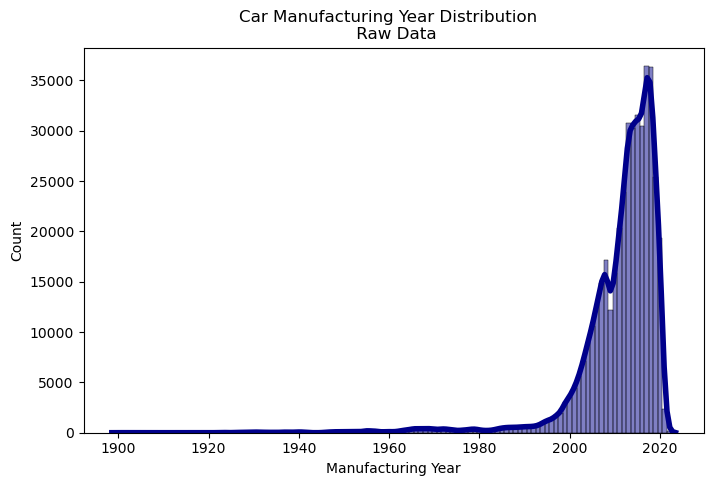

In [17]:
#year column histogram
fig, ax = plt.subplots(figsize=(8, 5))
sns.histplot(data['year'],discrete=True,color='darkblue', edgecolor='black',kde=True, kde_kws={'cut': 2}, line_kws={'linewidth': 4},
             bins = 10)
plt.xlabel('Manufacturing Year')
plt.title('Car Manufacturing Year Distribution  \n Raw Data')

<span style="color:blue">***Assupmtion:*** a car is not older than 1886 (when the first car was created) but let's assume we don't sale cars older than 1940</span>

In [18]:
# identify all rows withvalue less than 1850 ore more than 2200 
bad_year_index = data[(data['year'] < 1940) ].index
print('number of bad rows identified: ', len(bad_year_index))

number of bad rows identified:  726


In [19]:
#... and drop them
if len(bad_year_index) == 0:
    print("no bad years found")
else:
    data.drop(bad_year_index, axis=0, inplace=True)
    data.reset_index()

In [20]:
# remove nans
data['year']=data['year'].dropna()

In [21]:
data['year'].replace((np.inf, -np.inf, np.nan), 0).reset_index(drop=True)
data['year'].describe().astype(int)

count    424949
mean       2011
std           8
min        1940
25%        2008
50%        2013
75%        2017
max        2022
Name: year, dtype: int32

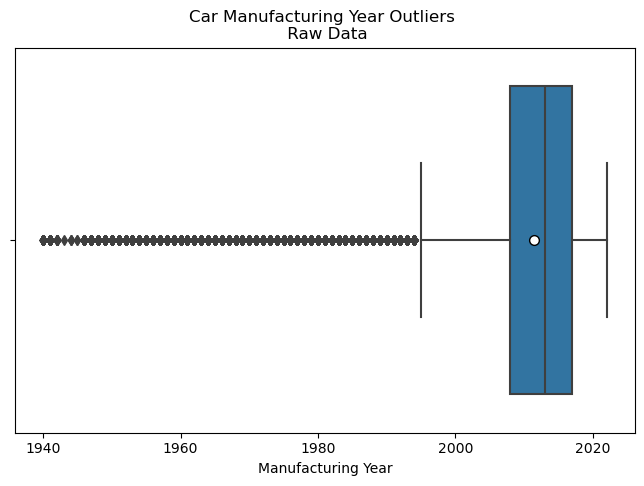

In [22]:
# let's look at the outliers
fig, ax = plt.subplots(figsize=(8, 5))
sns.boxplot(x=data["year"],showmeans=True,meanprops={"marker":"o",
                       "markerfacecolor":"white", 
                       "markeredgecolor":"black",
                       "markersize":"7"}).set_title('Car Manufacturing Year Outliers \n Raw Data')
plt.xlabel('Manufacturing Year')
plt.show()

<span style="color:blue">***observation:***</span> the car manufacturing year data looks good at this point

***clean up: odometer column***

Text(0, 0.5, 'Frequency')

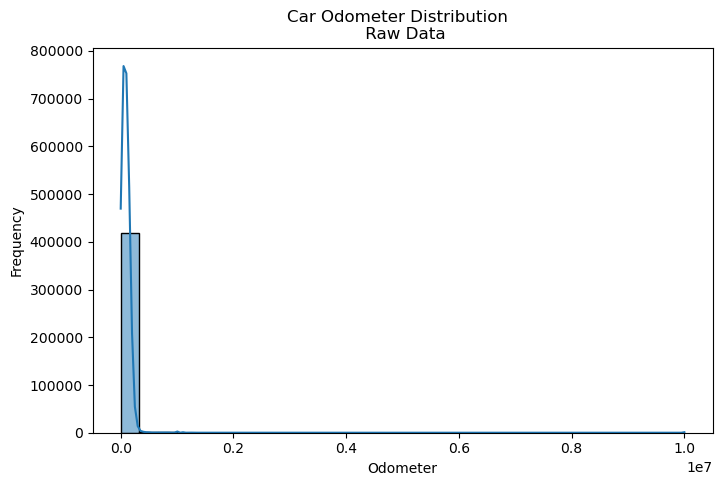

In [23]:
#odometer distribution
fig, ax = plt.subplots(figsize=(8, 5))
sns.histplot(data['odometer'], kde=True, bins=30)
plt.title('Car Odometer Distribution  \n Raw Data')
plt.xlabel('Odometer')
plt.ylabel('Frequency')

In [24]:
# remove nans
data['odometer']=data['odometer'].dropna()

In [25]:
data['odometer'].replace((np.inf, -np.inf, np.nan), 0).reset_index(drop=True)
data['odometer'].describe().astype(int)

count      421766
mean        97957
std        210107
min             0
25%         37815
50%         85662
75%        133700
max      10000000
Name: odometer, dtype: int32

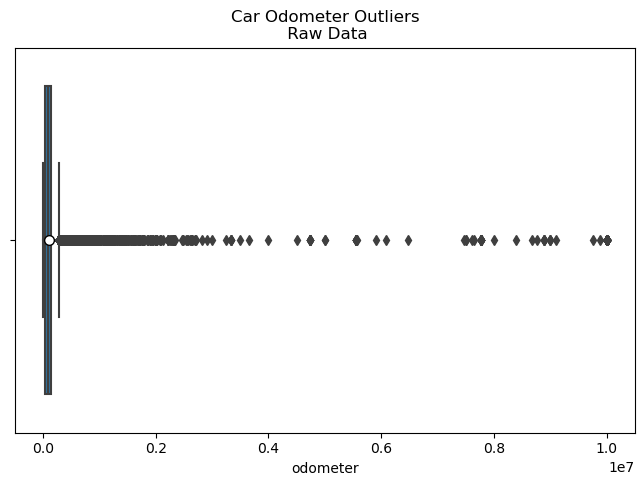

In [26]:
fig, ax = plt.subplots(figsize=(8, 5))
sns.boxplot(x=data["odometer"],showmeans=True,meanprops={"marker":"o",
                       "markerfacecolor":"white", 
                       "markeredgecolor":"black",
                      "markersize":"7"}).set_title('Car Odometer Outliers\n Raw Data')
plt.show()

In [27]:
# remove outliers
od_upper_limit = data['odometer'].quantile(0.95)
od_lower_limit = data['odometer'].quantile(0.05)
#remove odometer outliers
data = data[(data['odometer'] <= od_upper_limit) & (data['odometer'] >= od_lower_limit)]

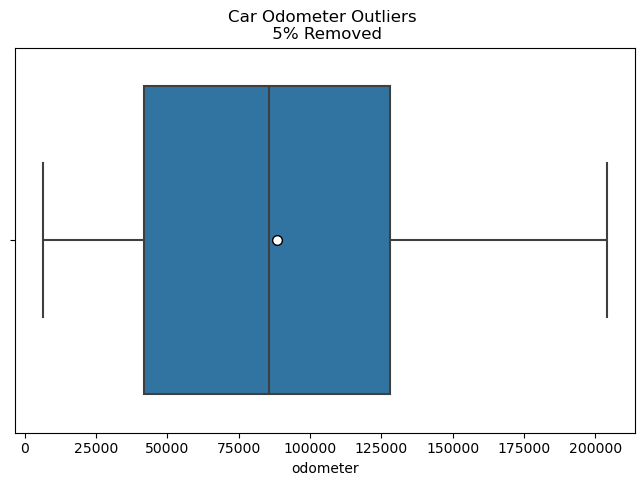

In [28]:
fig, ax = plt.subplots(figsize=(8, 5))
sns.boxplot(x=data["odometer"],showmeans=True,meanprops={"marker":"o",
                       "markerfacecolor":"white", 
                       "markeredgecolor":"black",
                      "markersize":"7"}).set_title('Car Odometer Outliers \n 5% Removed')
plt.show()

<span style="color:blue">***observation:***</span> the car odometer data looks good at this point

***clean up: price column***

Text(0, 0.5, 'Frequency')

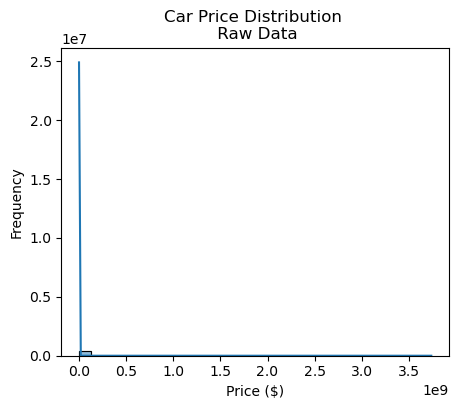

In [29]:
#price distribution
fig, ax = plt.subplots(figsize=(5, 4))
sns.histplot(data['price'], kde=True, bins=30)
plt.title('Car Price Distribution \n Raw Data')
plt.xlabel('Price ($)')
plt.ylabel('Frequency')

In [30]:
#identify all rows with 'price' with value less than or equal to 0
bad_price_index = data[(data['price'] <= 0) ].index
print(bad_price_index.shape[0])

27409


In [31]:
#... and drop them
if len(bad_price_index) == 0:
    print("no bad prices found")
else:
    data = data.drop(bad_price_index)
    data.reset_index()

In [32]:
# remove nans
data['price']=data['price'].dropna()

In [33]:
data['price'].replace((np.inf, -np.inf, np.nan), 0).reset_index(drop=True)
data['price'].describe().astype(int)

count        352224
mean          59878
std        10263088
min               1
25%            7800
50%           15758
75%           27500
max     -2147483648
Name: price, dtype: int32

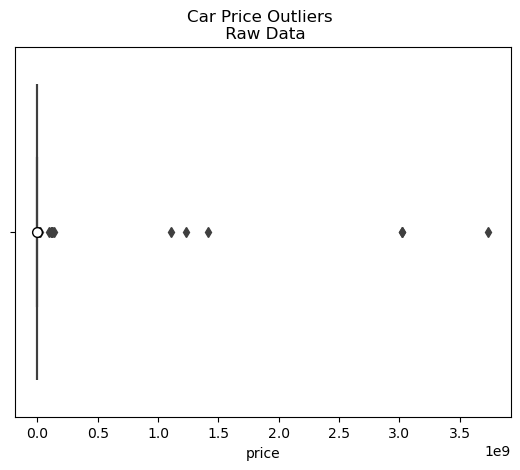

In [34]:
sns.boxplot(x=data["price"],showmeans=True,meanprops={"marker":"o",
                       "markerfacecolor":"white", 
                       "markeredgecolor":"black",
                      "markersize":"7"}).set_title('Car Price Outliers \n Raw Data')
plt.show()

***Remove outliers in the Price column***

In [35]:
price_upper_limit = data['price'].quantile(0.95)
price_lower_limit = data['price'].quantile(0.05)
#remove outliers
data = data[(data['price'] <= price_upper_limit) & (data['price'] >= price_lower_limit)]


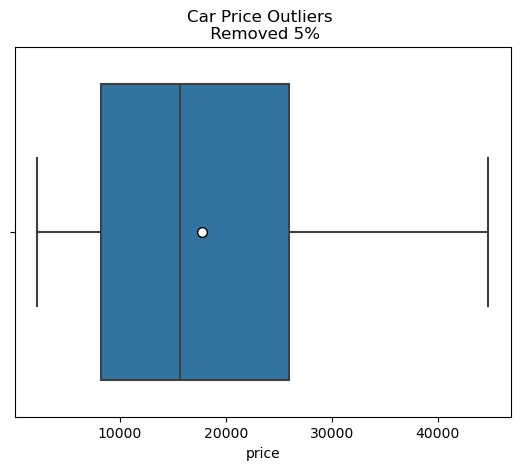

In [36]:
ax = sns.boxplot(x=data["price"],showmeans=True,meanprops={"marker":"o",
                       "markerfacecolor":"white", 
                       "markeredgecolor":"black",
                      "markersize":"7"}).set_title('Car Price Outliers \n Removed 5%')
plt.show()

In [37]:
data['price'].replace((np.inf, -np.inf, np.nan), 0).reset_index(drop=True)
data['price'].describe().astype(int)

count    317251
mean      17773
std       10930
min        2200
25%        8200
50%       15700
75%       25990
max       44795
Name: price, dtype: int32

<span style="color:blue">***observation:***</span> the car price column looks good right now. This column gave me alot of issues during testing, at first I did not notice that in the original data the max = -2147483648

***drop nan in all columns***

In [38]:
data = data.dropna().reset_index()
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69165 entries, 0 to 69164
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   index         69165 non-null  int64  
 1   price         69165 non-null  int64  
 2   year          69165 non-null  float64
 3   manufacturer  69165 non-null  object 
 4   condition     69165 non-null  object 
 5   fuel          69165 non-null  object 
 6   odometer      69165 non-null  float64
 7   transmission  69165 non-null  object 
 8   size          69165 non-null  object 
 9   type          69165 non-null  object 
dtypes: float64(2), int64(2), object(6)
memory usage: 5.3+ MB


***Examine correlations***

In [39]:
# to look at correlations encode non numeric columns, so create a temp df
to_encode_cols = ['fuel', 'transmission', 'type']
temp_df = data.copy()
for col in to_encode_cols:
        new_col = col+'_encoded'
        temp_df[new_col] = OrdinalEncoder().fit_transform(temp_df[[col]])

In [40]:
# we want to include manufacturer, so create an temp df with dummy values
encoded_manf_temp_df = pd.get_dummies(temp_df['manufacturer'],dtype='int')

In [41]:
# merge the encoded columns
merged_encoded_df = pd.concat([temp_df,data['price'], encoded_manf_temp_df], ignore_index=True, sort=False)
merged_encoded_df = merged_encoded_df.drop(columns=['index'])
merged_encoded_df.replace([np.inf, -np.inf,np.nan], 0, inplace=True)

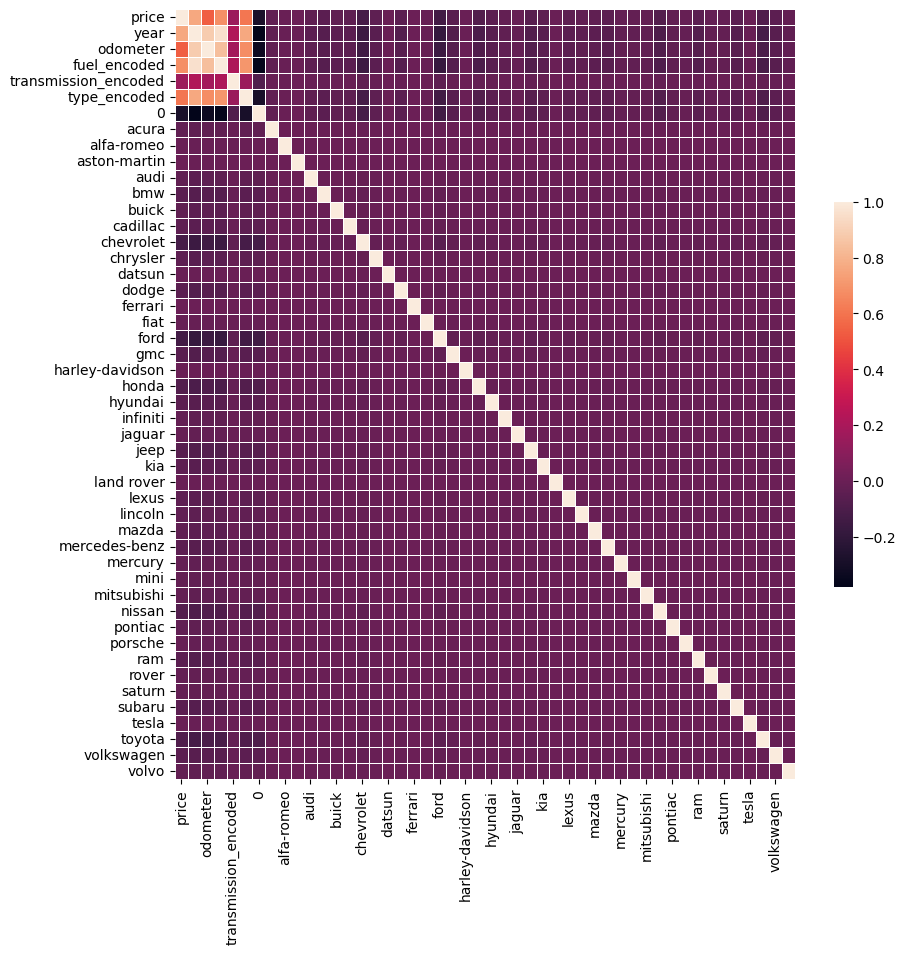

In [42]:
#plotting the heatmap for correlation
fig, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(merged_encoded_df.select_dtypes('number').corr(), annot=False,linewidths=.5, # Width of lines that divide cells
                cbar_kws={"shrink": .5}  # Extra kwargs for the legend; in this case, shrink by 50%
                )
plt.show()

<span style="color:blue">***observation:***</span> from the correlation above price is affected by year, odometer and type

**Visualizations**

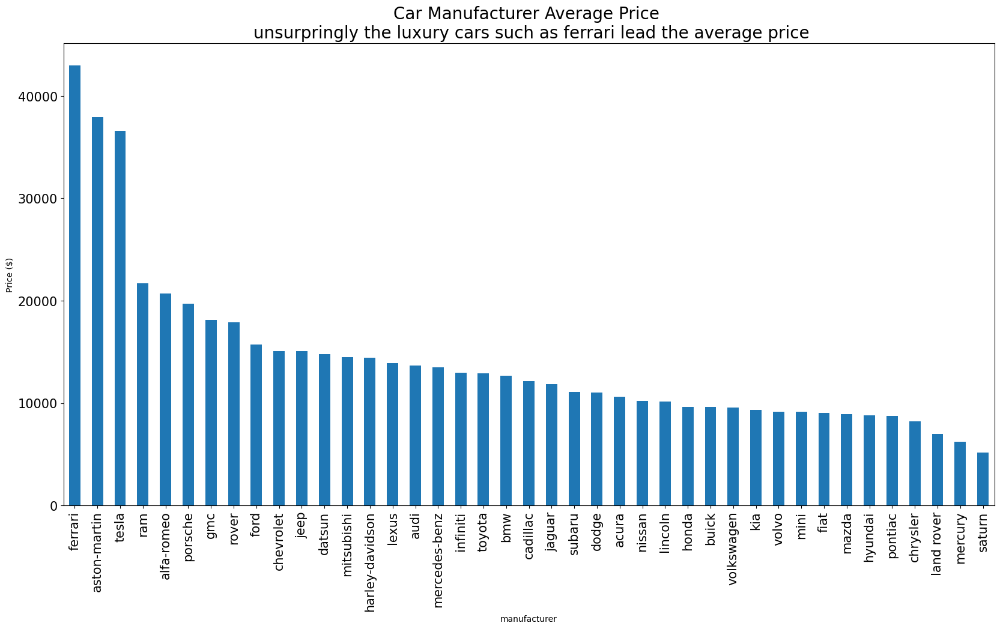

In [43]:
# average price of cars by manufacturer
plt.figure(figsize = (20, 10))
data.groupby(['manufacturer'])['price'].mean().sort_values(ascending = False).plot(kind = 'bar', fontsize = 15)
plt.title('Car Manufacturer Average Price \n unsurpringly the luxury cars such as ferrari lead the average price', fontsize = 20)
plt.ylabel("Price ($)")
plt.show()

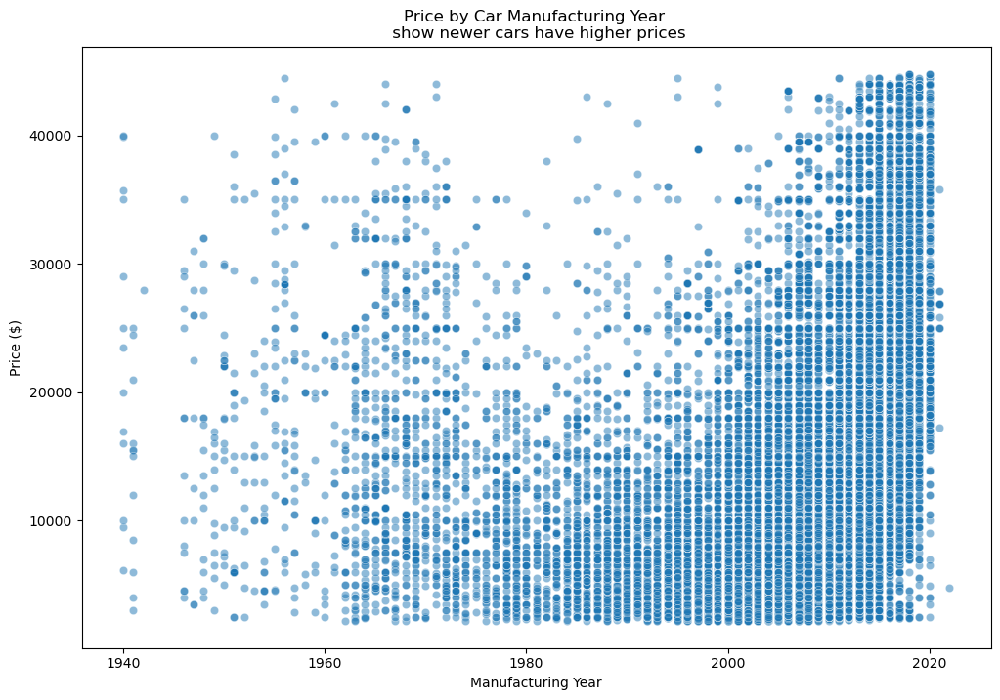

In [44]:
# price by car yr
plt.figure(figsize=(12, 8))
sns.scatterplot(x='year', y='price', data=data, alpha=0.5)
plt.title('Price by Car Manufacturing Year \n show newer cars have higher prices')
plt.xlabel('Manufacturing Year')
plt.ylabel('Price ($)')
plt.show()

<span style="color:blue">***observation:***</span> older cars are generally cheaper and newer cars more expensive. Also, luxury cars are more expensive. 

***Finish data cleanup***

In [45]:
updated_df = data.copy()

In [46]:
# for ease of reference, let's keep orig columns around
updated_df['orig_price'] = data['price'].copy()
updated_df['orig_odometer'] = data['odometer'].copy()
updated_df['orig_year'] = data['year'].copy()

In [47]:
numerical_cols = ['odometer','year'] #.select_dtypes(include=np.number).columns.tolist()

<span style="color:blue">***NOTE:***</span> the following section is added to fix errors during model.fit

valueerror input contains nan 

ValueError: Input contains NaN, infinity or a value too large for dtype('float64')

In [48]:
np.array(9e99).astype(np.float64)
np.array(9e99).astype(np.float32)

array(inf, dtype=float32)

In [49]:
updated_df.replace([np.inf, -np.inf,np.nan], 0, inplace=True)

### X and y should be based on the data up to this point so make a copy

In [50]:
data_to_model_df = updated_df.copy()
scaled_df = updated_df.copy()

## for analysis normalize and scale data

In [51]:
#normalize num cols
scaled_df['price'] = (scaled_df['price'] - scaled_df['price'].mean()) / scaled_df['price'].std()
scaled_df['odometer'] = (scaled_df['odometer'] - scaled_df['odometer'].mean()) / scaled_df['odometer'].std()
scaled_df['year'] = (scaled_df['year'] - scaled_df['year'].mean()) / scaled_df['year'].std()

In [52]:
#scaler transform of the dataset
temp_df = scaled_df[['price','odometer','year']]
mm_trx = MinMaxScaler()
num_data = mm_trx.fit_transform(temp_df)
trx_dataset = pd.DataFrame(num_data) #back to a dataframetrx_dataset

In [53]:
scaled_df['price'] = trx_dataset[0]
scaled_df['odometer'] = trx_dataset[1]
scaled_df['year'] = trx_dataset[2]
# summarize
print(scaled_df.describe())

               index         price          year      odometer    orig_price  \
count   69165.000000  69165.000000  69165.000000  69165.000000  69165.000000   
mean   214467.251341      0.260949      0.838517      0.529747  13315.138929   
std    120363.655145      0.219984      0.110402      0.240460   9370.236716   
min        31.000000      0.000000      0.000000      0.000000   2200.000000   
25%    112156.000000      0.089212      0.804878      0.355600   6000.000000   
50%    215190.000000      0.183120      0.865854      0.537186  10000.000000   
75%    315124.000000      0.370818      0.902439      0.711463  17995.000000   
max    426833.000000      1.000000      1.000000      1.000000  44795.000000   

       orig_odometer     orig_year  
count   69165.000000  69165.000000  
mean   111102.422049   2008.758360  
std     47502.350903      9.053001  
min      6452.000000   1940.000000  
25%     76700.000000   2006.000000  
50%    112572.000000   2011.000000  
75%    147000.000000

In [54]:
scaled_df.replace([np.inf, -np.inf,np.nan], 0, inplace=True)

### Visualizations

<Axes: xlabel='year', ylabel='Count'>

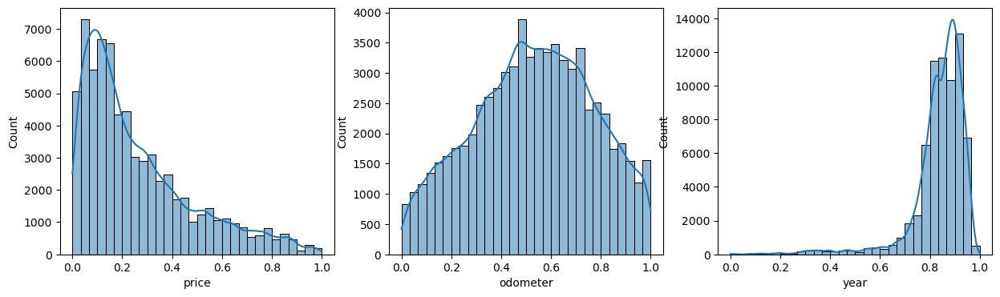

In [55]:
#price distribution
fig, axes = plt.subplots(1,3,figsize=(15, 4))
sns.histplot(scaled_df['price'], kde=True, bins=30,ax=axes[0])
sns.histplot(scaled_df['odometer'], kde=True, bins=30,ax=axes[1])
sns.histplot(scaled_df['year'], kde=True, bins=30,ax=axes[2])

##### -Manufacturer

In [56]:
plt.figure(figsize=(10, 6))
fig = px.scatter(data_frame=scaled_df, y="manufacturer", x="orig_price", color="orig_year", labels={"Price":"Car price $"},
                 title = 'Car Manufacturer and Price by Car Manufacturing Year')
fig.show()

<Figure size 1000x600 with 0 Axes>

##### -Odometer

In [57]:
fig = px.scatter(data_frame=scaled_df, y="odometer", x="orig_price", color="type", labels={"Odometer":"Car price $"},
                 title = 'Car Odometer and Price by Car Type')
fig.show()

##### -Year

In [58]:
fig = px.scatter(data_frame=scaled_df, y="year", x="orig_price", color="type", labels={"Year":"Car price $"},
                 title = 'Car Manufacturing Year and Price by Car Type')
fig.show()

##### -Condition

In [59]:
fig = px.scatter(data_frame=scaled_df, y="condition", x="orig_price", color="type", labels={"Year":"Car price $"},
                 title = 'Car Condition and Price by Car Type')
fig.show()

##### -Size

In [60]:
fig = px.scatter(data_frame=scaled_df, y="size", x="orig_price", color="type", labels={"Year":"Car price $"},
                 title = 'Car Size and Price by Car Type')
fig.show()

<span style="color:blue">***observation:***</span> at this point it seems that sixe, and condition need more investigation and may not be driving this data set's price. Howeveryear, odometer, fuel and type look promising as factors for car price predictions.

# 5. Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

**calculate X and y**

In [61]:
#the data to be modeled
#X = data_to_model_df[['manufacturer','year','odometer','condition', 'fuel', 'transmission', 'size', 'type']]
X = data_to_model_df[['manufacturer','year','odometer', 'fuel', 'transmission', 'type']]
y = data_to_model_df['price']

In [62]:
#train - 80%, test - 20%
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42, shuffle = True)

In [63]:
#let's take a look
split_type = ['X_train', 'X_test','y_train','y_test']
shape_info = [X_train.shape, X_test.shape, y_train.shape, y_test.shape]
split_results_df = pd.DataFrame({'data_split': split_type, 'shape': shape_info})
split_results_df

,data_split,shape
0,X_train,"(55332, 6)"
1,X_test,"(13833, 6)"
2,y_train,"(55332,)"
3,y_test,"(13833,)"


## 5.1. Linear Regression models

### 5.1.1. Model1: Linear regression

In [64]:
#create a linear regression model
lregr_1_model = LinearRegression()
#train the model using the training sets
lregr_1_model.fit(X_train[numerical_cols], y_train)

LinearRegression()

In [65]:
#linear reg train meadian absolute error
lregr_1_mdae_train = median_absolute_error(y_train, lregr_1_model.predict(X_train[numerical_cols]))
#linear reg train mean sq error
lregr_1_mse_train = mean_squared_error(y_train, lregr_1_model.predict(X_train[numerical_cols]))
#linear reg train mean absolute error
lregr_1_mae_train = mean_absolute_error(y_train, lregr_1_model.predict(X_train[numerical_cols]))

In [66]:
#make predictions using the testing set
lregr_1_y_pred = lregr_1_model.predict(X_test[numerical_cols])

In [67]:
#linear regression coefficiets
lregr_1_coefficients = lregr_1_model.coef_
#liner regression mean sq error
lregr_1_mse = mean_squared_error(y_test, lregr_1_y_pred)
#liner regression r sq with 1 being perfect prediction
lregr_1_r2 = r2_score(y_test, lregr_1_y_pred)

print('LinearRegression r^2: ', lregr_1_r2)

LinearRegression r^2:  0.24107120287116424


In [68]:
#linear reg test mean sq error
lregr_1_mse_test = mean_squared_error(y_test, lregr_1_y_pred)

In [69]:
lregr_1_imp = permutation_importance(lregr_1_model, X_train[numerical_cols], y_train, n_repeats=20, random_state=42, n_jobs=-1)
lregr_1_imp_df = pd.DataFrame(data=lregr_1_imp.importances_mean, 
                              index=X_train[numerical_cols].columns, 
                              columns=['Importance']).sort_values(by='Importance', ascending=False)
lregr_1_imp_df.head()

,Importance
odometer,0.340527
year,0.112720


### 5.1.2. Model2: Ridge regression

In [70]:
#create a Ridge regression model
ridge_1_model = Ridge(alpha=0.1)
#train the model using the training sets
ridge_1_model.fit(X_train[numerical_cols], y_train)

Ridge(alpha=0.1)

In [71]:
#ridge train mean sq error
ridge_1_mse_train = mean_squared_error(y_train, ridge_1_model.predict(X_train[numerical_cols]))

In [72]:
#make predictions using the testing set
ridge_1_y_pred = ridge_1_model.predict(X_test[numerical_cols])

In [73]:
#ridge regression coefficiets
ridge_1_coefficients = ridge_1_model.coef_
#ridge regression mean sq error
ridge_1_mse = mean_squared_error(y_test, ridge_1_y_pred)
#ridge regression r sq with 1 being perfect prediction
ridge_1_r2 = r2_score(y_test, ridge_1_y_pred)

print('Ridge r^2: ', ridge_1_r2)

Ridge r^2:  0.24107120291683903


In [74]:
#ridge regression error
ridge_1_mse_test = mean_squared_error(y_test, ridge_1_y_pred)

In [75]:
ridge_1_imp = permutation_importance(ridge_1_model, X_train[numerical_cols], y_train, n_repeats=20, random_state=42, n_jobs=-1)
ridge_1_imp_df = pd.DataFrame(data=ridge_1_imp.importances_mean, 
                              index=X_train[numerical_cols].columns, 
                              columns=['Importance']).sort_values(by='Importance', ascending=False)
ridge_1_imp_df.head()

,Importance
odometer,0.340527
year,0.112720


### 5.1.3. Model3: Lasso regression

In [76]:
#create a lasso regression model
lasso_1_model = Lasso(alpha=0.1)
#train the model using the training sets
lasso_1_model.fit(X_train[numerical_cols], y_train)

Lasso(alpha=0.1)

In [77]:
#lasso train mean sq error
lasso_1_mse_train = mean_squared_error(y_train, lasso_1_model.predict(X_train[numerical_cols]))

In [78]:
#make predictions using the testing set
lasso_1_y_pred = lasso_1_model.predict(X_test[numerical_cols])

In [79]:
#lasso regression coefficiets
lasso_1_coefficients = lasso_1_model.coef_
#lasso regression mean sq error
lasso_1_mse = mean_squared_error(y_test, lasso_1_y_pred)
#lasso regression r sq with 1 being perfect prediction
lasso_1_r2 = r2_score(y_test, lasso_1_y_pred)

print('Lasso r^2: ', lasso_1_r2)

Lasso r^2:  0.2410712131873436


In [80]:
#lasso regression error
lasso_1_mse_test = mean_squared_error(y_test, lasso_1_y_pred)

In [81]:
lasso_1_imp = permutation_importance(lasso_1_model, X_train[numerical_cols], y_train, n_repeats=20, random_state=42, n_jobs=-1)
lasso_1_imp_df = pd.DataFrame(data=lasso_1_imp.importances_mean, 
                              index=X_train[numerical_cols].columns, 
                              columns=['Importance']).sort_values(by='Importance', ascending=False)
lasso_1_imp_df.head()

,Importance
odometer,0.340527
year,0.112720


## 5.2. Linear models with regularization

***Create Preprocessor***

In [82]:
cat_cols = ['fuel', 'transmission', 'type']
num_cols = ['year','odometer']
manuf_col = ['manufacturer']
preprocessor = make_column_transformer(
    (OneHotEncoder(drop="if_binary"), cat_cols),
    (StandardScaler(), num_cols ),
    (OneHotEncoder(drop="if_binary"), manuf_col), #to control what to do with manufacturer
   # remainder ='passthrough',
    verbose_feature_names_out=False,  # avoid to prepend the preprocessor names
)

In [83]:
categorical_features = ['condition', 'fuel', 'transmission', 'size', 'type']
numeric_features = ['year','odometer']
manufacturer_feature = ['manufacturer']

    
numeric_transformer = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="median")), 
           ("scaler",  StandardScaler()),
           ("polfeat", PolynomialFeatures(degree=3, include_bias=False))
          ])

categorical_transformer = Pipeline(
    steps=[
        ("encoder",  OneHotEncoder(handle_unknown="ignore")),
        #("selector", SelectPercentile(chi2, percentile=50)),
    ])

manufacturer_transformer = Pipeline(
    steps=[
        ("encoder",  OneHotEncoder(handle_unknown="ignore")),
        #("selector", SelectPercentile(chi2, percentile=50)),
    ])

preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
        ("manuf", manufacturer_transformer, manufacturer_feature),
    ])

preprocessor = make_column_transformer(
    (OneHotEncoder(drop="if_binary"), cat_cols),
    (StandardScaler(), num_cols ),
    (OneHotEncoder(drop="if_binary"), manuf_col), #to control what to do with manufacturer
   # remainder ='passthrough',
    verbose_feature_names_out=False,  # avoid to prepend the preprocessor names
)

### 5.2.1. Model: RidgeCV with alphas=np.logspace(-10, 10, 21)

In [84]:
#create model
alphas_2 = np.logspace(-10, 10, 21)  # alpha values to be chosen from by cross-validation
ridge_2_model = make_pipeline(
    preprocessor,
    TransformedTargetRegressor(
        regressor=RidgeCV(alphas=alphas_2),
        func=np.log10,
        inverse_func=sp.special.exp10,        
    ),    
)

In [85]:
#... and fit the model
#ridge_model = ridge_model.fit_transform(X_train, y_train)#,nan_policy='omit')
ridge_2_model = ridge_2_model.fit(X_train, y_train)

In [86]:
ridge_2_model

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('onehotencoder-1',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['fuel', 'transmission',
                                                   'type']),
                                                 ('standardscaler',
                                                  StandardScaler(),
                                                  ['year', 'odometer']),
                                                 ('onehotencoder-2',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['manufacturer'])],
                                   verbose_feature_names_out=False)),
                ('transformedtargetregressor',
                 TransformedTargetRegressor(func=<ufunc 'log10'>,
                                            inverse_func=<ufunc 'exp10'>,
                                            regressor=RidgeCV(alphas=array([1.e-10, 1.e-09, 1.e-08, 1.e-07, 1.e-06, 1.e-05, 1.e-04, 1.e-03,
       1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02, 1.e+03, 1.e+04, 1.e+05,
       1.e+06, 1.e+07, 1.e+08, 1.e+09, 1.e+10]))))])

***ridge permutation importance***

In [87]:
ridge_2_r = permutation_importance(ridge_2_model, X_test, y_test,
                           n_repeats=30,
                           random_state=0)
for i in ridge_2_r.importances_mean.argsort()[::-1]:
    if ridge_2_r.importances_mean[i] - 2 * ridge_2_r.importances_std[i] > 0:
        print(f"{X.columns[i] :<11}"
              f"{ridge_2_r.importances_mean[i]:.3f}"
              f" +/- {ridge_2_r.importances_std[i]:.3f}")

odometer   0.431 +/- 0.008
type       0.415 +/- 0.009
year       0.166 +/- 0.004
manufacturer0.085 +/- 0.005
fuel       0.082 +/- 0.003


***ridge selected alpha, MAE, MSE***

In [88]:
#ridge train mean sq error
ridge_2_mse_train = mean_squared_error(y_train, ridge_2_model.predict(X_train))

In [89]:
#ridge prediction
ridge_2_y_pred = ridge_2_model.predict(X_test)

In [90]:
ridge_2_mse_test = mean_squared_error(y_test, ridge_2_y_pred)

In [91]:
#ridge selected alpha
ridge_2_selected_alpha = ridge_2_model[-1].regressor_.alpha_

In [92]:
#ridge regression mean sq error
ridge_2_mse_test = mean_squared_error(y_test, ridge_2_y_pred)

In [93]:
#ridge regression r sq with 1 being perfect prediction
ridge_2_r2 = r2_score(y_test, ridge_2_y_pred)
print('Ridge r^2: ', ridge_2_r2)

Ridge r^2:  0.5696652090335164


## 5.3. GridSearchCV

In [94]:
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

In [95]:
params = [ {'model__alpha': np.arange(0.01, 0.25, 10) } ]

gridsearch_pipeline = Pipeline(
    steps=[
        ("preprocessor", preprocessor), 
        ("model", Ridge(),
        )]
)
grid_search = GridSearchCV(gridsearch_pipeline, params, scoring='neg_mean_squared_error', cv=5, verbose=1)

In [96]:
grid_search

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('onehotencoder-1',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['fuel',
                                                                          'transmission',
                                                                          'type']),
                                                                        ('standardscaler',
                                                                         StandardScaler(),
                                                                         ['year',
                                                                          'odometer']),
                                                                        ('onehotencoder-2',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['manufacturer'])],
                                                          verbose_feature_names_out=False)),
                                       ('model', Ridge())]),
             param_grid=[{'model__alpha': array([0.01])}],
             scoring='neg_mean_squared_error', verbose=1)

In [97]:
#... and fit the model with the X,y datase
#grid_search.fit(X_train, y_train)
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('onehotencoder-1',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['fuel',
                                                                          'transmission',
                                                                          'type']),
                                                                        ('standardscaler',
                                                                         StandardScaler(),
                                                                         ['year',
                                                                          'odometer']),
                                                                        ('onehotencoder-2',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['manufacturer'])],
                                                          verbose_feature_names_out=False)),
                                       ('model', Ridge())]),
             param_grid=[{'model__alpha': array([0.01])}],
             scoring='neg_mean_squared_error', verbose=1)

In [98]:
#best params
best_param = grid_search.best_params_
best_param

{'model__alpha': 0.01}

In [99]:
#best score
grid_search.best_score_

nan

In [100]:
#best model
best_model = grid_search.best_estimator_

In [101]:
best_y_train = best_model.predict(X_train)
best_y_train.size

55332

In [102]:
#gridsearchcv test mean sq error
gridscv_mse_train = mean_squared_error(y_train, best_y_train)

In [103]:
gridscv_y_pred = best_model.predict(X_test)
gridscv_y_pred.size

13833

In [104]:
#gridsearchcv test median absolute error
gridscv_mdae_test = median_absolute_error(y_test, gridscv_y_pred)
#gridsearchcv test mean sq error
gridscv_mse_test = mean_squared_error(y_test, gridscv_y_pred)
#gridsearchcv test mean absolute error
gridscv_mae_test = mean_absolute_error(y_test, gridscv_y_pred)
print('GridSearchCV best model absolute error on test data set: ', gridscv_mae_test)

GridSearchCV best model absolute error on test data set:  4542.520154495056


In [105]:
best_r2 = r2_score(y_test, gridscv_y_pred)
print('GridSearchCV best model r^2: ', best_r2)

GridSearchCV best model r^2:  0.5623820554478546


# 6. Modeling Results

## 5.1. Linear Regression models

***Result Summary: Linear Regression Model***

In [106]:
model_type = ['regressor=LinearRegression  ', 'regressor=Ridge \n (alpha=0.1) ','regressor=Lasso \n (alphas=0.1) ']
mse_train = [lregr_1_mse_train, ridge_1_mse_train, lasso_1_mse_train]
mse_test = [lregr_1_mse_test,ridge_1_mse_test,lasso_1_mse_test]
model_r2 = [lregr_1_r2, ridge_1_r2, lasso_1_r2]

result_df = pd.DataFrame({'model': model_type, 
                          'Model r^2': model_r2,
                          'MSE on train set': mse_train,
                          'MSE on testing set': mse_test
                         })
HTML(result_df.to_html(classes='table table-stripped'))

,model,Model r^2,MSE on train set,MSE on testing set
0,regressor=LinearRegression,0.241071,6.515457e+07,6.783581e+07
1,regressor=Ridge \n (alpha=0.1),0.241071,6.515457e+07,6.783581e+07
2,regressor=Lasso \n (alphas=0.1),0.241071,6.515457e+07,6.783581e+07


***Model Prediction Error: Linear Regression Model***

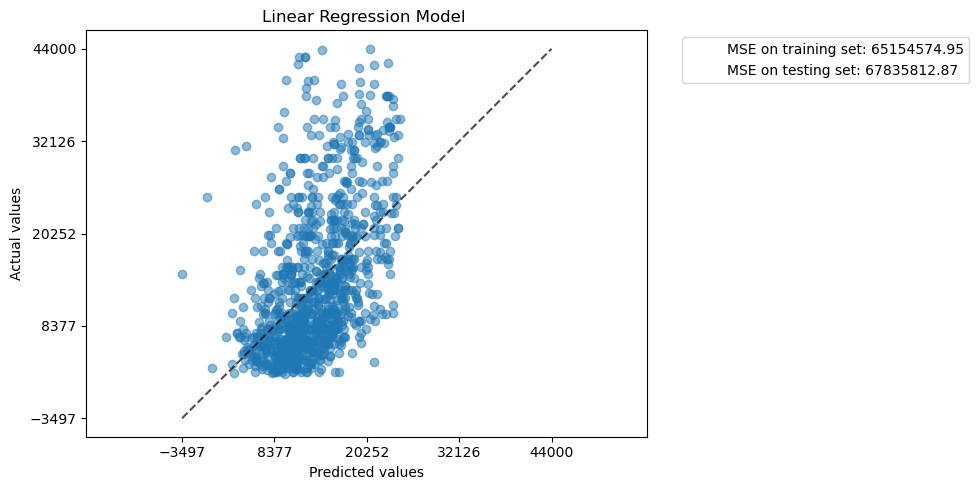

In [107]:
lregr_1_pred_score = {
    "MSE on training set": f"{lregr_1_mse_train:.2f}",
    "MSE on testing set": f"{lregr_1_mse_test:.2f}",
}
_, ax = plt.subplots(figsize=(10, 5))
display = PredictionErrorDisplay.from_predictions(y_test, lregr_1_y_pred, kind="actual_vs_predicted", ax=ax, scatter_kwargs={"alpha": 0.5})
ax.set_title('Linear Regression Model ')
for name, score in lregr_1_pred_score.items():
    ax.plot([], [], " ", label=f"{name}: {score}")
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

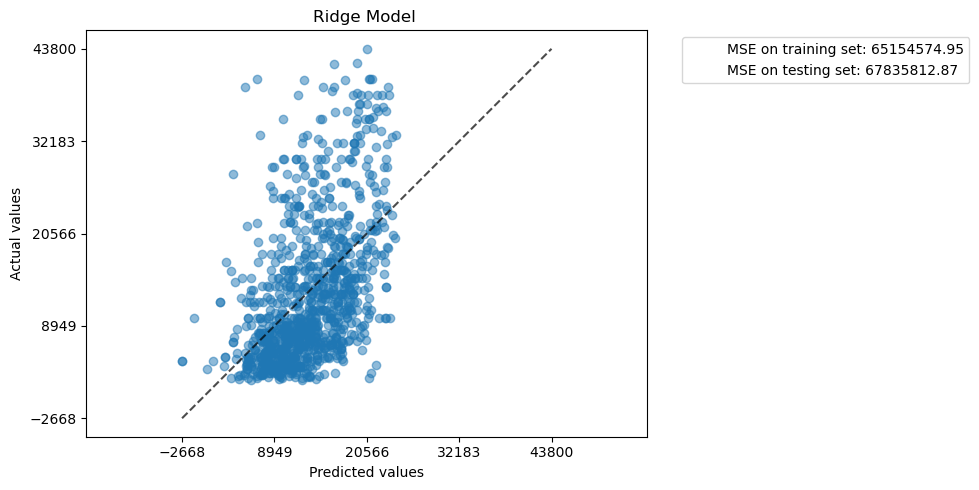

In [108]:
ridge_1_pred_score = {
    "MSE on training set": f"{ridge_1_mse_train:.2f}",
    "MSE on testing set": f"{ridge_1_mse_test:.2f}",
}
_, ax = plt.subplots(figsize=(10, 5))
display = PredictionErrorDisplay.from_predictions(y_test, ridge_1_y_pred, kind="actual_vs_predicted", ax=ax, scatter_kwargs={"alpha": 0.5})
ax.set_title('Ridge Model ')
for name, score in ridge_1_pred_score.items():
    ax.plot([], [], " ", label=f"{name}: {score}")
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

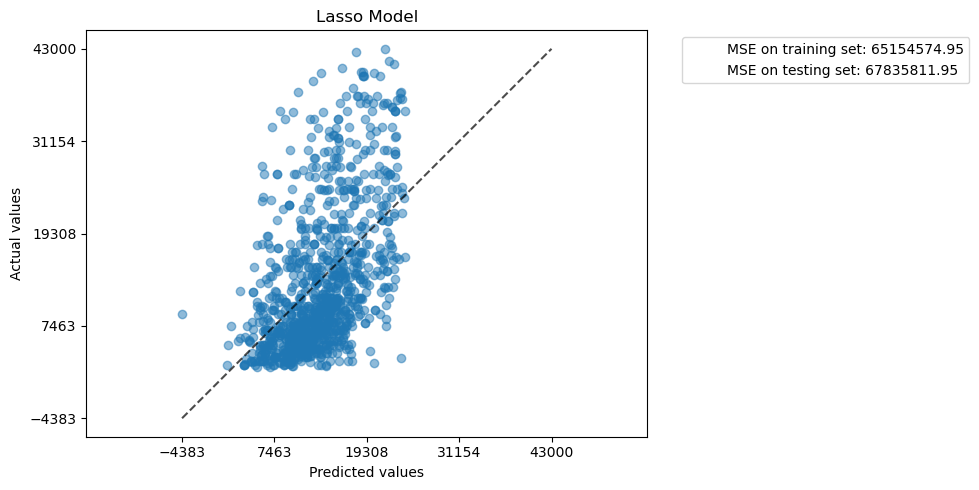

In [109]:
lasso_1_pred_score = {
    "MSE on training set": f"{lasso_1_mse_train:.2f}",
    "MSE on testing set": f"{lasso_1_mse_test:.2f}",
}

_, ax = plt.subplots(figsize=(10, 5))
display = PredictionErrorDisplay.from_predictions(y_test, lasso_1_y_pred, kind="actual_vs_predicted", ax=ax, scatter_kwargs={"alpha": 0.5})
ax.set_title('Lasso Model')
for name, score in lasso_1_pred_score.items():
    ax.plot([], [], " ", label=f"{name}: {score}")
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

## 6.2. Linear models with regularization

***Result Summary: Linear Model with Regularization***

In [110]:
model_type = ['regressor=Ridge   (alpha=np.logspace(-10, 10, 21))  ']
result_df = pd.DataFrame({'model': model_type,
                          'selected alpha': ridge_2_selected_alpha,
                          'Model r^2': ridge_2_r2,
                          'MSE on train set': ridge_2_mse_train,
                          'MSE on testing set': ridge_2_mse_test
                         })
HTML(result_df.to_html(classes='table table-stripped'))

,model,selected alpha,Model r^2,MSE on train set,MSE on testing set
0,"regressor=Ridge (alpha=np.logspace(-10, 10, 21))",0.1,0.569665,3.621024e+07,3.846489e+07


***Coefficient Visualization: Linear Model with Regularization***

In [111]:
ridge_2_feature_names = ridge_2_model[:-1].get_feature_names_out()
ridge_2_coefs = pd.DataFrame(
    ridge_2_model[-1].regressor_.coef_,
    columns=["Coefficients importance"],
    index=ridge_2_feature_names,
)

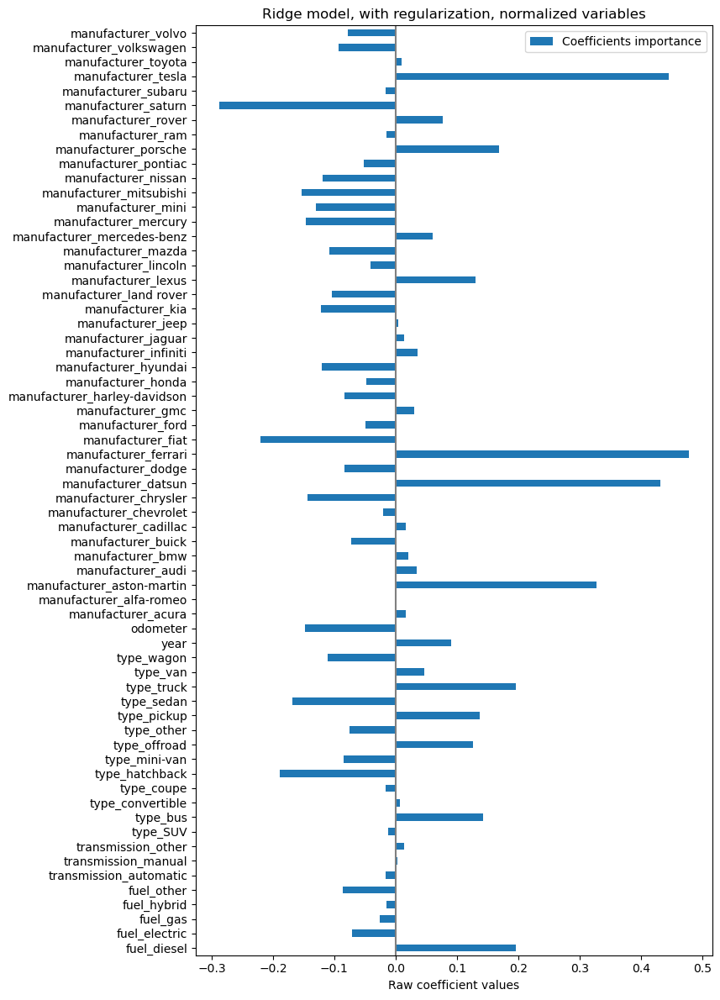

In [112]:
ridge_2_coefs.plot.barh(figsize=(9, 12))
plt.title("Ridge model, with regularization, normalized variables")
plt.xlabel("Raw coefficient values")

plt.axvline(x=0, color=".5")
plt.tight_layout() 
plt.subplots_adjust(left=0.3)
plt.show()

***Model Prediction Error: Linear Model with Regularization***

In [113]:
ridge_2_pred_score = {
    "MSE on training set": f"{ridge_2_mse_train:.2f}",
    "MSE on testing set": f"{ridge_2_mse_test:.2f}",
}

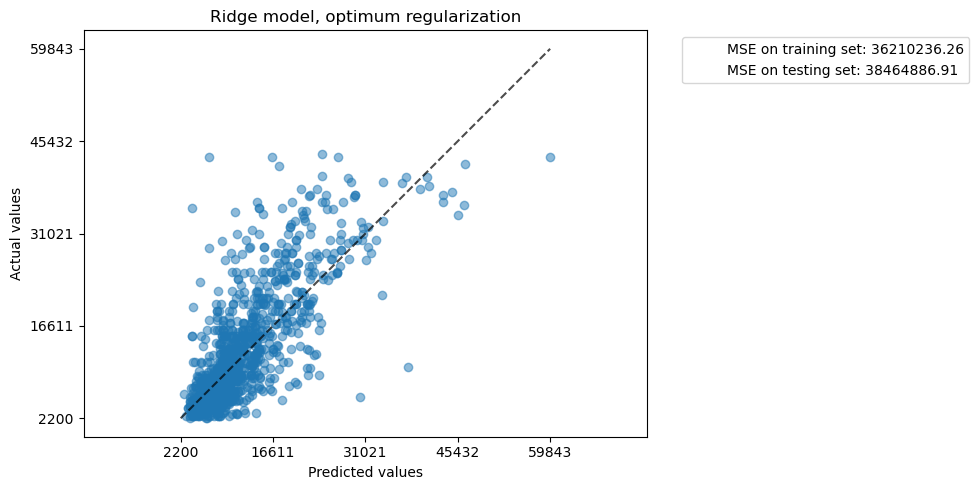

In [114]:
_, ax = plt.subplots(figsize=(10, 5))
display = PredictionErrorDisplay.from_predictions(y_test, ridge_2_y_pred, kind="actual_vs_predicted", ax=ax, scatter_kwargs={"alpha": 0.5})
ax.set_title('Ridge model, optimum regularization')
for name, score in ridge_2_pred_score.items():
    ax.plot([], [], " ", label=f"{name}: {score}")
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

## 6.3. GridSearchCV

***Results Summary: GridSearchCV***

In [115]:
result_df = pd.DataFrame({'model': 'GridSearchCV with Ridge and alphas=[1, 10, 20, 50, 100, 150, 200, 250, 500, 1000]',
                          'selected alpha': best_param,
                          'Model r^2': best_r2,
                          'MSE on train set': gridscv_mse_train,
                          'MSE on testing set': gridscv_mse_test
                         })
HTML(result_df.to_html(classes='table table-stripped'))

,model,selected alpha,Model r^2,MSE on train set,MSE on testing set
model__alpha,"GridSearchCV with Ridge and alphas=[1, 10, 20, 50, 100, 150, 200, 250, 500, 1000]",0.01,0.562382,3.699130e+07,3.911588e+07


***Coefficient Visualization: GridSearchCV for best model selected***

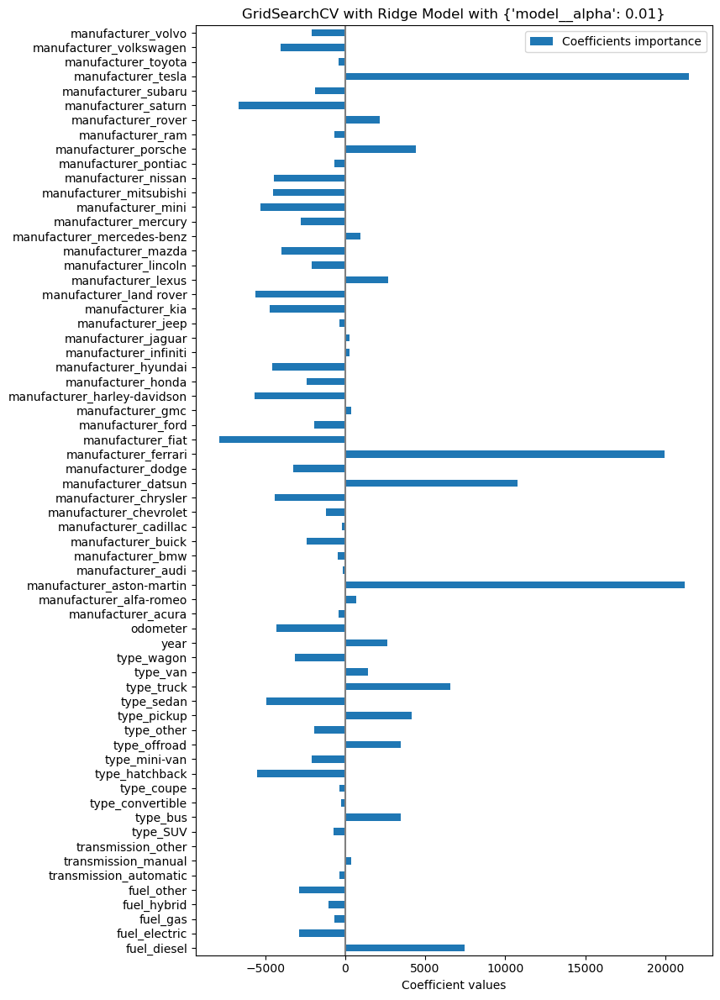

In [116]:
feature_names = best_model[:-1].get_feature_names_out()
coefs = pd.DataFrame(
    best_model[-1].coef_,
    columns=["Coefficients importance"],
    index=feature_names
)


coefs.plot.barh(figsize=(9, 12))
titlestr= "GridSearchCV with Ridge Model with "+ str(best_param)
plt.title(titlestr)
plt.xlabel("Coefficient values")

plt.axvline(x=0, color=".5")
plt.tight_layout() 
plt.subplots_adjust(left=0.3)
plt.show()

***Model Prediction Error: GridSearchCV for best model selected***

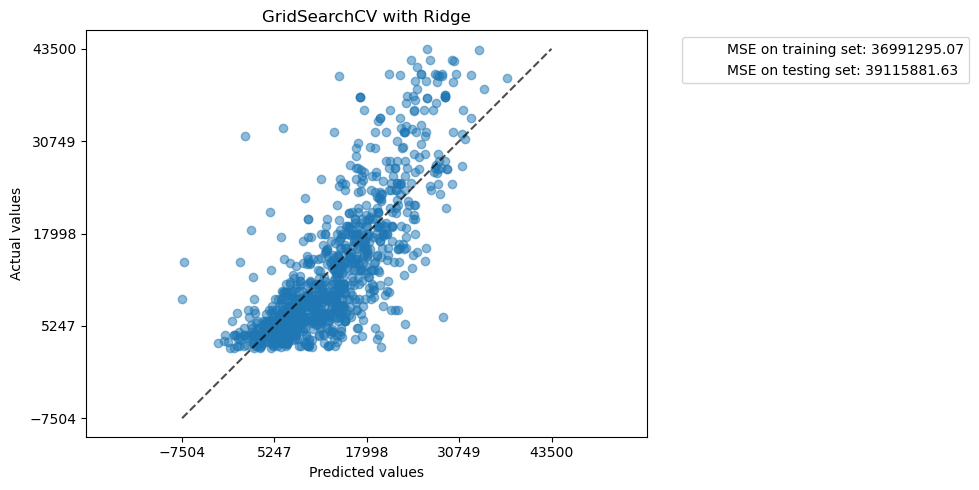

In [117]:
grid_pred_score = {
    "MSE on training set": f"{gridscv_mse_train:.2f}",
    "MSE on testing set": f"{gridscv_mse_test:.2f}",
}

_, ax = plt.subplots(figsize=(10, 5))
display = PredictionErrorDisplay.from_predictions(y_test, gridscv_y_pred, kind="actual_vs_predicted", ax=ax, scatter_kwargs={"alpha": 0.5})
ax.set_title("GridSearchCV with Ridge")
for name, score in grid_pred_score.items():
    ax.plot([], [], " ", label=f"{name}: {score}")
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()


# 7. Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

Base on the r^2 values the best model is Ridge with alpha = 0.01 which gives us an r^2 = 0.562382 
which is not very high at all, I attempted to increase that value by removing some columns but it did not work. 
The next steps would be to try different models and data transformations.
Meanwhile, using the results of this model I would recommend for the car salesmen to 
1- target newer cars with low odometer readings 
2- target luxury cars manufacturers such as ferrari and aston-martin
3- target trucks with diesel
